In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

from time import time
import numpy as np 
from numpy import savetxt, loadtxt, asarray
import matplotlib.pyplot as plt

from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.datasets import load_digits
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
import sklearn.preprocessing as preprocessing

from progressbar import ProgressBar
from tqdm import tqdm
pbar = ProgressBar()
tqdm.pandas()


### Aws paths

In [6]:
%pycache
path_raw_val = '/data_predictor/good_data/parsed_nondups_val_3.csv'
path_raw_train = '/data_predictor/good_data/parsed_nondups_train_3.csv'

UsageError: Line magic function `%pycache` not found.


### Local paths

In [7]:
path_raw_val = '/Users/roxanefischer/Desktop/single_path_nas/single-path-nas/HAS/data/good_data/parsed_nondups_val_3.csv'
path_raw_train = '/Users/roxanefischer/Desktop/single_path_nas/single-path-nas/HAS/data/good_data/parsed_nondups_train_3.csv'

In [19]:

train_hw = pd.read_csv(path_raw_train)
val_hw = pd.read_csv(path_raw_val)

y_train = np.array(train_hw["total_power"].tolist())
y_train=y_train.reshape(y_train.shape[0],-1)

y_val = np.array(val_hw["total_power"].tolist())
y_val=y_val.reshape(y_val.shape[0],-1)



In [20]:
data = pd.concat([train_hw , val_hw], ignore_index=True)

In [21]:
X_train_hw_param  = train_hw[['mac_num', 'mac_array_num', 'data_bits', 'sram_size', 'max_filter_size']]
#X_train_hw_param['tot_mac'] = X_train_hw_param['mac_num']*X_train_hw_param['mac_array_num']

X_val_hw_param  = val_hw[['mac_num', 'mac_array_num', 'data_bits', 'sram_size', 'max_filter_size']]
#X_val_hw_param['tot_mac'] = X_val_hw_param['mac_num']*X_val_hw_param['mac_array_num']

X_train_hw_param.head()

,mac_num,mac_array_num,data_bits,sram_size,max_filter_size
0,118.0,2.0,256.0,179968.0,2048.0
1,87.0,2.0,512.0,99968.0,2048.0
2,124.0,2.0,512.0,99968.0,3072.0
3,80.0,2.0,1024.0,99968.0,1024.0
4,86.0,2.0,512.0,60000.0,1536.0


In [22]:
train_hw.head()

,mac_num,mac_array_num,data_bits,sram_size,max_filter_size,G,C,B,J,name,bw_power,core_power,total_power
0,118.0,2.0,256.0,179968.0,2048.0,3.636011e+06,18770712.0,19987780.0,0.000533,0.0,79.951120,21.330414,101.281534
1,87.0,2.0,512.0,99968.0,2048.0,2.325259e+06,14362735.0,21849702.0,0.000570,0.0,87.398808,22.816285,110.215093
2,124.0,2.0,512.0,99968.0,3072.0,2.533459e+06,12739050.0,21849702.0,0.000543,0.0,87.398808,21.716202,109.115010
3,80.0,2.0,1024.0,99968.0,1024.0,2.327509e+06,12155422.0,21849702.0,0.000684,0.0,87.398808,27.343500,114.742308
4,86.0,2.0,512.0,60000.0,1536.0,1.728057e+06,16407889.0,28402776.0,0.000604,0.0,113.611104,24.174307,137.785411


# Low power < 100 : 69% dataset

<class 'numpy.ndarray'>


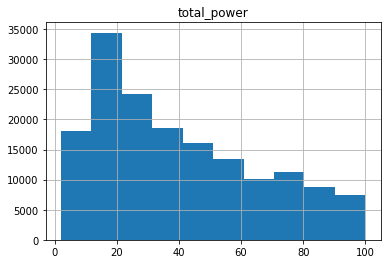

In [23]:
low_hist = data[(data["total_power"] < 100)].hist(column="total_power")
print(type(low_hist))
plt.savefig("low_hist.png")

# Middle power 100< < 1000 : 30% dataset

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a11d048d0>]],
      dtype=object)

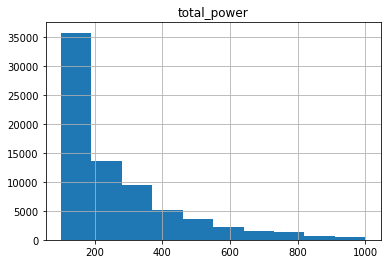

In [24]:
data[ (1000>data["total_power"]) &(data["total_power"]>=100) ].hist(column="total_power")


# High power > 1000 : 1,6% dataset

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a11e8ca20>]],
      dtype=object)

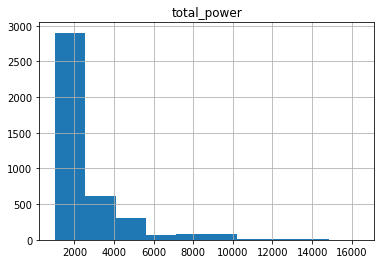

In [25]:
data[(data["total_power"] >= 1000)].hist(column="total_power")


# PCA (scaled)

([<matplotlib.axis.XTick at 0x1a128c3160>,
 <a list of 6 Text xticklabel objects>)

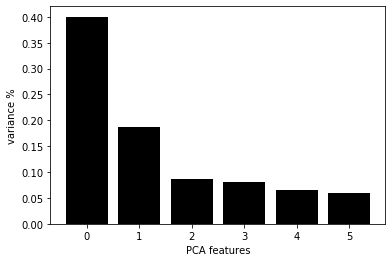

In [26]:
pca = PCA(n_components=6).fit(scale(data))
principalComponents = pca.fit_transform(scale(data))
PCA_components = pd.DataFrame(principalComponents)

features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')
plt.xlabel('PCA features')
plt.ylabel('variance %')
plt.xticks(features)



# Inv

In [27]:
def inv(x):
    return 1/(1+x)

inversed=False
if inversed : 
#nb_hw_param = 6
    nb_hw_param = 12
    X_train_hw_param['1/mac_num'] = X_train_hw_param['mac_num'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/mac_array_num'] = X_train_hw_param['mac_array_num'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/data_bits'] = X_train_hw_param['data_bits'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/sram_size'] = X_train_hw_param['sram_size'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/max_filter_size'] = X_train_hw_param['max_filter_size'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/tot_mac'] = X_train_hw_param['tot_mac'].progress_apply(lambda x : inv(x))


    X_val_hw_param['1/mac_num'] = X_val_hw_param['mac_num'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/mac_array_num'] = X_val_hw_param['mac_array_num'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/data_bits'] = X_val_hw_param['data_bits'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/sram_size'] = X_val_hw_param['sram_size'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/max_filter_size'] = X_val_hw_param['max_filter_size'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/tot_mac'] = X_val_hw_param['tot_mac'].progress_apply(lambda x : inv(x))


In [28]:

scaler = preprocessing.StandardScaler().fit(X_train_hw_param)

X_train_hw_param_norm= scaler.transform(X_train_hw_param)
X_val_hw_param_norm = scaler.transform(X_val_hw_param )
pd.DataFrame(X_train_hw_param_norm).head()

,0,1,2,3,4
0,0.855641,-0.489793,-0.647015,0.529144,0.332994
1,0.300127,-0.489793,-0.258452,-0.373136,0.332994
2,0.963160,-0.489793,-0.258452,-0.373136,1.196488
3,0.174689,-0.489793,0.518673,-0.373136,-0.530500
4,0.282208,-0.489793,-0.258452,-0.823915,-0.098753


In [29]:
data_hw = pd.concat([pd.DataFrame(X_train_hw_param_norm), pd.DataFrame(X_val_hw_param_norm)], ignore_index=True)

# K-means

In [30]:
n_clusters = 10
n_samples = (X_train_hw_param).shape[0]
n_features = (X_train_hw_param).shape[1]



In [39]:
kmeans_not_reduced = KMeans(init='k-means++', n_clusters=n_clusters, n_init=10)
kmeans_not_reduced.fit(data_hw)
centroids_not_reduced = kmeans_not_reduced.cluster_centers_
#KMeans(init='random', n_clusters=n_digits, n_init=10)
#savetxt('/data_predictor/params/hw_centroids.csv', centroids_not_reduced, delimiter=',')

In [40]:
centroids_not_reduced

array([[-0.52952214, -0.30507208, -0.40114543, -0.32555519,  1.67370323],
       [ 0.2981056 ,  0.04560405,  0.37216801,  2.42351079,  0.25757565],
       [-0.54967462, -0.34201565, -0.46906207,  0.5284298 , -0.55383488],
       [ 1.49486472, -0.14831512,  2.0729236 , -0.20343458, -0.10015314],
       [ 0.04982365,  2.71808543,  0.3802606 , -0.19057496,  0.28514961],
       [ 0.58322454,  2.63207593,  0.39810208,  2.09019075,  0.41115211],
       [-0.48066638, -0.12629604,  2.07141681, -0.160053  ,  0.2286082 ],
       [ 1.56964611, -0.14342515,  0.31066158, -0.19083251,  1.75106594],
       [-0.49955897, -0.40621182, -0.5100282 , -0.5786837 , -0.5516825 ],
       [ 1.33879394, -0.27600475, -0.23497083, -0.33782767, -0.44388809]])

# Plot (PCA reduced)

In [41]:
reduced_data = PCA(n_components=2).fit_transform(scale(data))


kmeans = KMeans(init='k-means++', n_clusters=n_clusters, n_init=10)
y_pred =kmeans.fit_predict(reduced_data)
centroids = kmeans.cluster_centers_



In [42]:
centroids

array([[-6.48627408e-01,  9.91251277e-01],
       [ 4.43300487e+01,  5.73403501e+00],
       [ 4.39671553e+00, -9.01936061e-01],
       [ 2.07495645e+01,  1.62210830e+00],
       [ 2.62557523e-01, -4.47085997e+00],
       [ 1.00633100e+01, -1.15717409e-01],
       [-2.86114082e-01, -1.60356444e-01],
       [ 1.33055976e+00,  3.28293590e-01],
       [ 3.58896460e-02, -2.01258690e+00],
       [ 8.73711287e+01,  1.46497768e+01]])

In [43]:
(y_pred)

array([6, 0, 6, ..., 4, 8, 0], dtype=int32)

In [44]:
colors =iter(list(y_pred))

cols={
0: 'red',
1: 'green',
2: 'blue',
3: 'cyan',
4: 'magenta',
5: 'yellow',
6: 'black',
7 : 'darkgreen',
8: 'orange',
9:'darkblue',
}



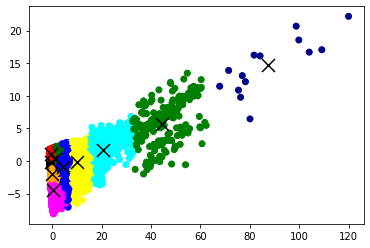

In [45]:
from itertools import *
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=[cols[ind] for ind in y_pred])
# Plot the centroids as a white X
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1],
            marker='x', s=169, linewidths=3,
            color='0', zorder=10)

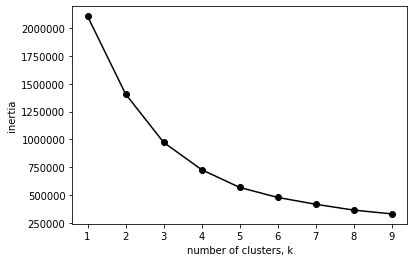

In [46]:
ks = range(1, 10)
inertias = []
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    model.fit(PCA_components.iloc[:,:3])
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
plt.plot(ks, inertias, '-o', color='black')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()